# Data exploration

In [1]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Data visualization
sns.set(style="darkgrid")
sns.set_context("notebook", font_scale=1.3)

# Path
path = "/Users/gauthier/workspace/PO"

In [2]:
df = pd.read_csv(os.path.join(path, "data", "data_processed.csv"))

df['date'] = df['date'].apply(lambda x : pd.Timestamp(x))

# Order by 'date'
df.sort_values(by='date', inplace=True)

# Reindex rows
df.reset_index(inplace=True)
df.drop(columns=['index'], inplace=True)

# Add time features
df['month'] = df['date'].apply(lambda x : x.month)
df['weekday'] = df['date'].apply(lambda x : x.weekday())
df['hour'] = df['date'].apply(lambda x : x.hour) 

In [3]:
df.head()

,date,CBN,month,weekday,hour
0,2018-07-21 04:52:46,0 05,7,5,4
1,2018-07-21 04:52:49,0 05,7,5,4
2,2018-07-21 04:52:57,0 05,7,5,4
3,2018-07-21 04:53:01,0 05,7,5,4
4,2018-07-21 04:53:04,0 05,7,5,4


## Exploration - Repartition

#### Month, weekdays and hours

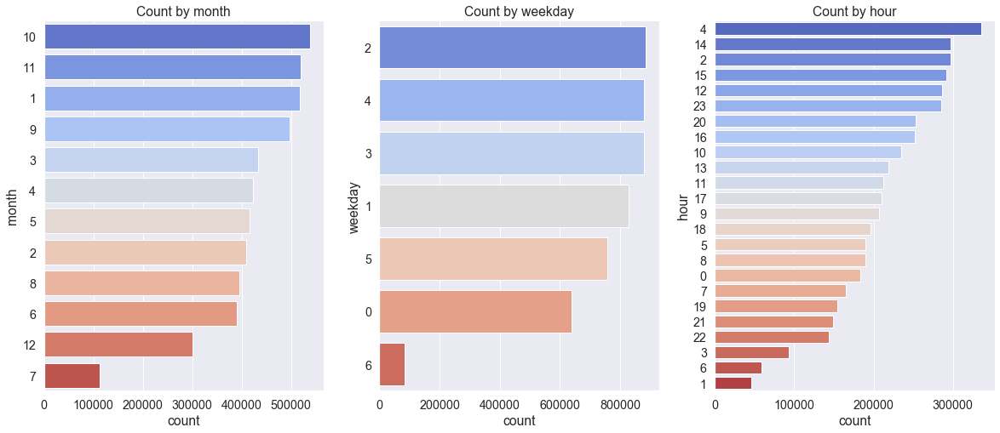

In [5]:
f, axes = plt.subplots(1, 3, figsize=(20, 8))

axes[0].set_title("Count by month")
sns.countplot(y='month', data=df, palette='coolwarm',  order=df['month'].value_counts().index, ax=axes[0])

axes[1].set_title("Count by weekday")
sns.countplot(y='weekday', data=df, palette='coolwarm', order=df['weekday'].value_counts().index, ax=axes[1])

axes[2].set_title("Count by hour")
sns.countplot(y='hour', data=df, palette='coolwarm', order=df['hour'].value_counts().index, ax=axes[2])

#### CBN

In [6]:
df_CBN = df['CBN'].value_counts()
tot = df_CBN.sum()
df_CBN = df_CBN/tot * 100

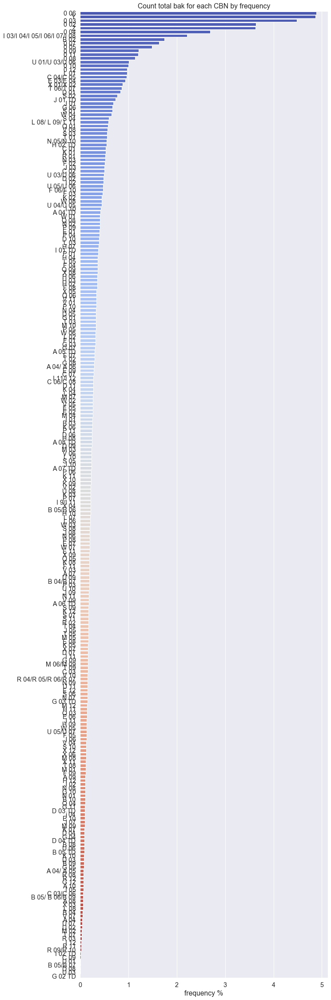

In [8]:
plt.figure(figsize = (10, 40))
plt.title("Count total bak for each CBN by frequency")
sns.barplot(x=df_CBN.values, y=df_CBN.index, palette='coolwarm')
plt.xlabel("frequency %")
plt.show()

There are 257 CBN let's take a look at CBN with a low frenquency

In [9]:
print("{} CBN with a frequency lower than 0.15%".format(df_CBN[df_CBN<0.15].shape[0]))

72 CBN with a frequency lower than 0.15%


In [12]:
def top_k(df, k):
    res = df.iloc[:,1:258].apply((lambda x : x.sort_values()[-k:][x.sort_values()[-k:] > 0]), axis=1)
    res.fillna(0, inplace=True)
    res[df.iloc[:,258:].columns] = df.iloc[:,258:]
    return res

## Exploration - top 10

In [13]:
df_2min = pd.read_csv(os.path.join(path, "data", "data_processed_2min_257"))

df_5min = pd.read_csv(os.path.join(path, "data", "data_processed_5min_257"))

df_15min = pd.read_csv(os.path.join(path, "data", "data_processed_15min_257"))

df_90min = pd.read_csv(os.path.join(path, "data", "data_processed_90min_257"))

# List des CBN
list_CBN = df_5min.columns[1:-7-24-12]

#### Computer how many times CBN appear in top 10

In [14]:
# Df of values of number bak when in top 10 and 0 o.w.
top10_5min = top_k(df_5min, 10)
top10_15min = top_k(df_15min, 10)
top10_90min = top_k(df_90min, 10)

# Number of times each CBN appear in top 10
top10_5min_appear = (top10_5min.iloc[:,:-12-7-24] > 0).sum().sort_values(ascending=False)
top10_15min_appear = (top10_15min.iloc[:,:-12-7-24] > 0).sum().sort_values(ascending=False)
top10_90min_appear = (top10_90min.iloc[:,:-12-7-16] > 0).sum().sort_values(ascending=False)

# Frequency of apparition in top 10
top10_5min_freq = top10_5min_appear / len(df_5min) * 100
top10_15min_freq = top10_15min_appear / len(df_15min) * 100
top10_90min_freq = top10_90min_appear / len(df_90min) * 100

# Total number of back for each CBN when in top 10
top10_5min_bak = top10_5min.iloc[:,:-12-7-24].sum()
top10_15min_bak = top10_15min.iloc[:,:-12-7-24].sum()
top10_90min_bak = top10_90min.iloc[:,:-12-7-16].sum()

# List of missing CBN in top 10
top10_5min_missingcbn = np.setdiff1d(list_CBN, top10_5min_appear.index)
top10_15min_missingcbn = np.setdiff1d(list_CBN, top10_15min_appear.index)
top10_90min_missingcbn = np.setdiff1d(list_CBN, top10_90min_appear.index)

### Time interval = 5min

There are 257 CBN appearing in top 10.


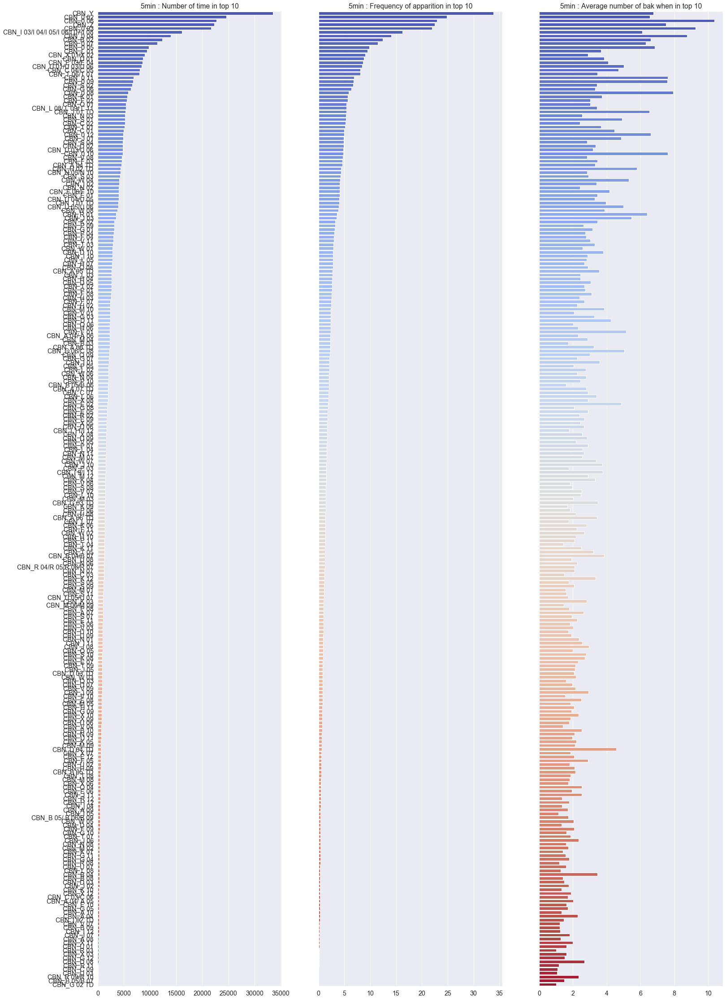

In [110]:
f, axes = plt.subplots(1, 3, figsize=(25, 40), sharey=True)

axes[0].set_title("5min : Number of time in top 10")
sns.barplot(x=top10_5min_appear.values, y=top10_5min_appear.index, palette='coolwarm', ax=axes[0])

axes[1].set_title("5min : Frequency of apparition in top 10")
sns.barplot(x=top10_5min_freq, y=top10_5min_appear.index, palette='coolwarm', ax=axes[1])

axes[2].set_title("5min : Average number of bak when in top 10")
sns.barplot(x=top10_5min_bak/top10_5min_appear, y=top10_5min_bak.index, palette='coolwarm', 
            order=top10_5min_appear.index, ax=axes[2])


print("There are {} CBN appearing in top 10.".format(len(top10_5min_missingcbn)))

All CBN appear in top 10 with an average bak number between 1 and 10.

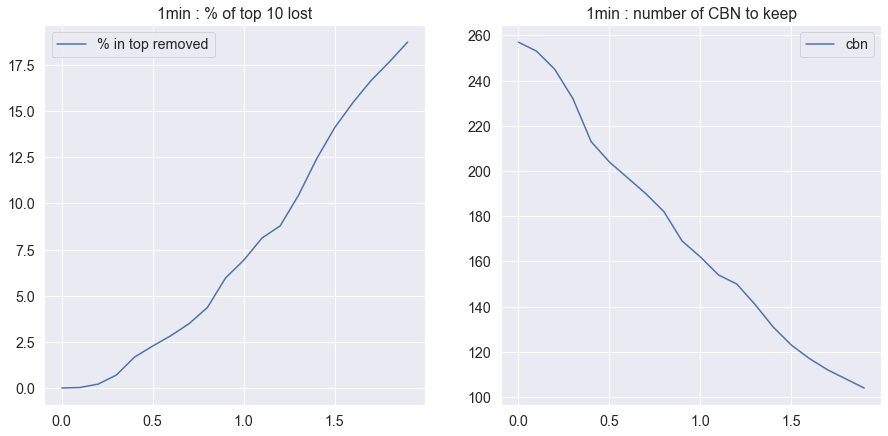

In [15]:
freq = np.linspace(0, 100, 1000)
pourc_top = []
cbn_intop = []

for f in freq:
    pourc_top.append(top10_5min_appear[top10_5min_freq <= f].sum() /top10_5min_appear.sum() * 100)
    cbn_intop.append(len(top10_5min_freq) - len(top10_15min_freq[(top10_5min_freq <= f)]))

f, axes = plt.subplots(1, 2, figsize=(15, 7))

axes[0].set_title("1min : % of top 10 lost")
axes[1].set_title("1min : number of CBN to keep")
sns.lineplot(freq[0:20], pourc_top[0:20], label='% in top removed', ax=axes[0])
sns.lineplot(freq[0:20], cbn_intop[0:20], label='cbn', ax=axes[1])

In [16]:
freq = 0.7
print("We keep ",len(top10_5min_freq) - len(top10_5min_freq[(top10_5min_freq <= freq)]), " CBN.")
print(top10_5min_appear[top10_5min_freq <= freq].sum() /top10_5min_appear.sum() * 100, "% top top 10 lost.")

We keep  190  CBN.
3.386494189223113 % top top 10 lost.


These 67 CBN we remove contributes to 3.38% of the top 10.

I know create a new data with CBN that appear in top 10 with a frequency > 0.7%.

In [19]:
# Dataframe with only 190CBN
col_save = ['date']
col_save.extend(top10_5min_freq[(top10_5min_freq > 0.7)].index)
col_save.extend(df_5min.columns[258:])


df_2min[col_save].to_csv(os.path.join(path, "data/data_processed_2min_190"), index=False)
df_5min[col_save].to_csv(os.path.join(path, "data/data_processed_5min_190"), index=False)

### Time interval = 15min

There are 256 CBN appearing in top 10.


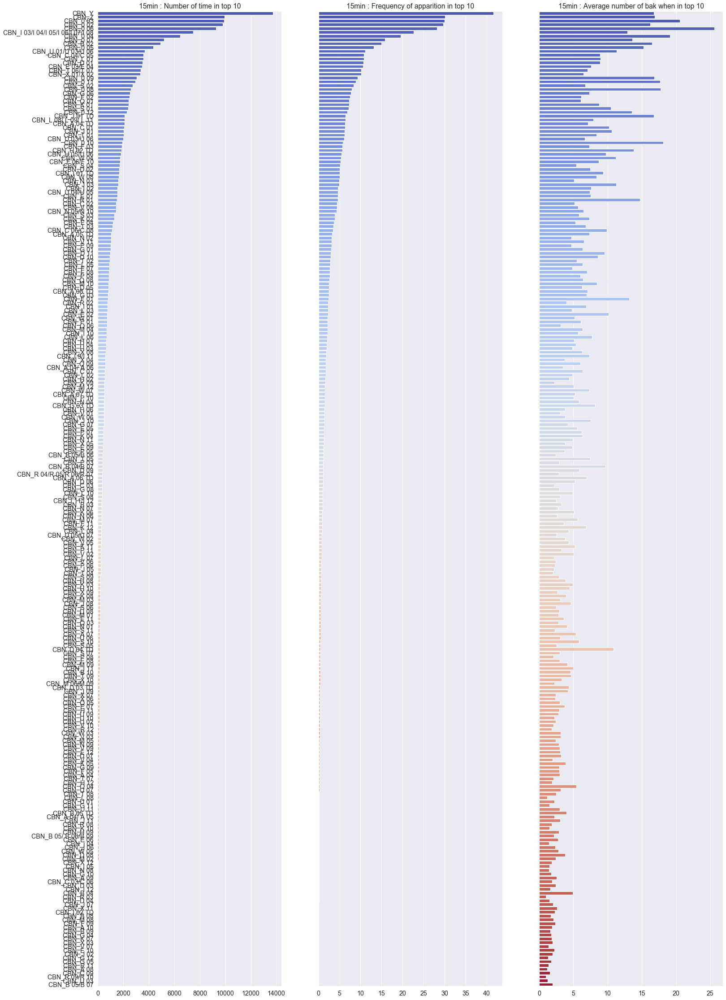

In [111]:
f, axes = plt.subplots(1, 3, figsize=(25, 40), sharey=True)

axes[0].set_title("15min : Number of time in top 10")
sns.barplot(x=top10_15min_appear.values, y=top10_15min_appear.index, palette='coolwarm', ax=axes[0])

axes[1].set_title("15min : Frequency of apparition in top 10")
sns.barplot(x=top10_15min_freq, y=top10_15min_appear.index, palette='coolwarm', ax=axes[1])

axes[2].set_title("15min : Average number of bak when in top 10")
sns.barplot(x=top10_15min_bak/top10_15min_appear, y=top10_15min_bak.index, palette='coolwarm', 
            order=top10_15min_appear.index, ax=axes[2])


print("There are {} CBN appearing in top 10.".format(len(top10_15min_missingcbn)))

One CBN doesn't appear in top 10.

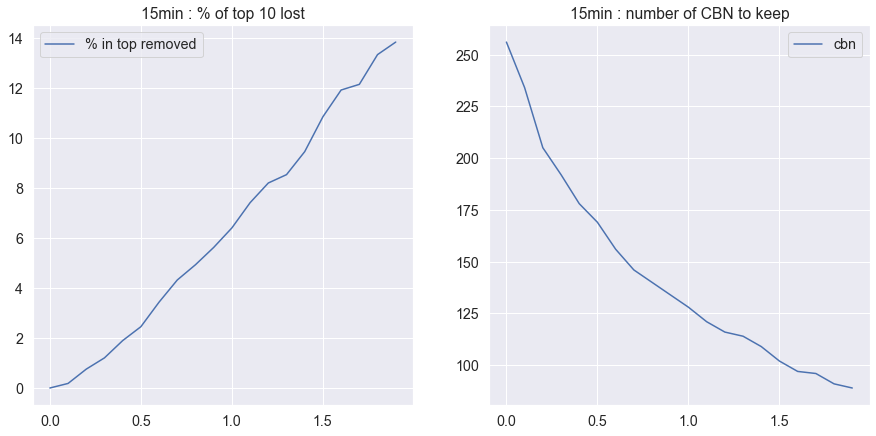

In [20]:
freq = np.linspace(0, 100, 1000)
pourc_top = []
cbn_intop = []

for f in freq:
    pourc_top.append(top10_15min_appear[top10_15min_freq <= f].sum() /top10_15min_appear.sum() * 100)
    cbn_intop.append(len(top10_15min_freq) - len(top10_15min_freq[(top10_15min_freq <= f)]))

f, axes = plt.subplots(1, 2, figsize=(15, 7))

axes[0].set_title("15min : % of top 10 lost")
axes[1].set_title("15min : number of CBN to keep")
sns.lineplot(freq[0:20], pourc_top[0:20], label='% in top removed', ax=axes[0])
sns.lineplot(freq[0:20], cbn_intop[0:20], label='cbn', ax=axes[1])

In [21]:
freq = 0.6
print("We keep ",len(top10_15min_freq) - len(top10_15min_freq[(top10_15min_freq <= freq)]), " CBN.")
print(top10_15min_appear[top10_15min_freq <= freq].sum() /top10_15min_appear.sum() * 100, "% top top 10 lost.")

We keep  157  CBN.
3.3517181110671417 % top top 10 lost.


These 123 CBN we remove contributes to 3.35% of the top 10.

I know create a new data with CBN that appear in top 10 with a frequency > 0.6%.

In [22]:
# Dataframe with only 157CBN
col_save = ['date']
col_save.extend(top10_15min_freq[(top10_15min_freq > 0.6)].index)
col_save.extend(df_5min.columns[258:])


df_2min[col_save].to_csv(os.path.join(path, "data/data_processed_2min_157"), index=False)
df_5min[col_save].to_csv(os.path.join(path, "data/data_processed_5min_157"), index=False)

### Time interval = 90min

There are 203 CBN appearing in top 10.


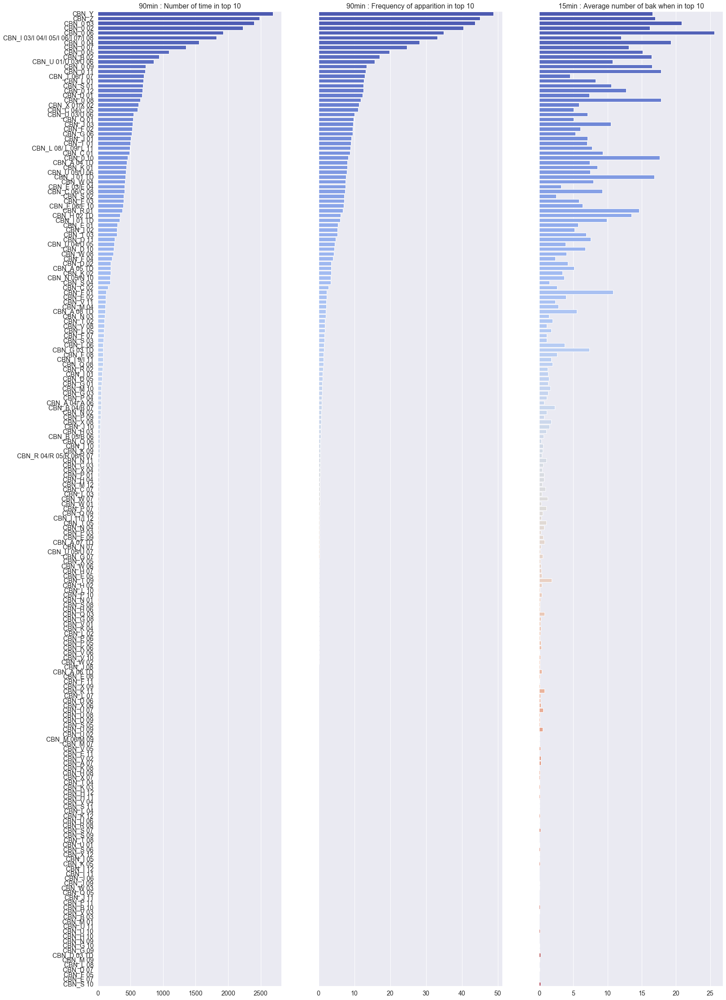

In [121]:
f, axes = plt.subplots(1, 3, figsize=(25, 40), sharey=True)

axes[0].set_title("90min : Number of time in top 10")
sns.barplot(x=top10_90min_appear.values, y=top10_90min_appear.index, palette='coolwarm', ax=axes[0])

axes[1].set_title("90min : Frequency of apparition in top 10")
sns.barplot(x=top10_90min_freq, y=top10_90min_appear.index, palette='coolwarm', ax=axes[1])

axes[2].set_title("15min : Average number of bak when in top 10")
sns.barplot(x=top10_90min_bak/top10_15min_appear, y=top10_15min_bak.index, palette='coolwarm', 
            order=top10_90min_appear.index, ax=axes[2])

print("There are {} CBN appearing in top 10.".format(len(top10_90min_missingcbn)))

There are 54 CBN wich never appear in top 10. Let's take a look at those who appear with a really low frequency.

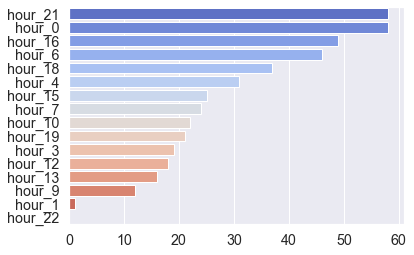

In [23]:
col = list(top10_90min_freq[(top10_90min_freq <= 0.5)].index)
index = (top10_90min[col].iloc[:,:-12-7-16] >0).sum(axis=1) > 0

# Hour when these CBN are in top 10
h = top10_90min[index].iloc[:,-12-7-16:].sum()[-16:].sort_values(ascending=False)
sns.barplot(x=h.values, y=h.index, palette='coolwarm')

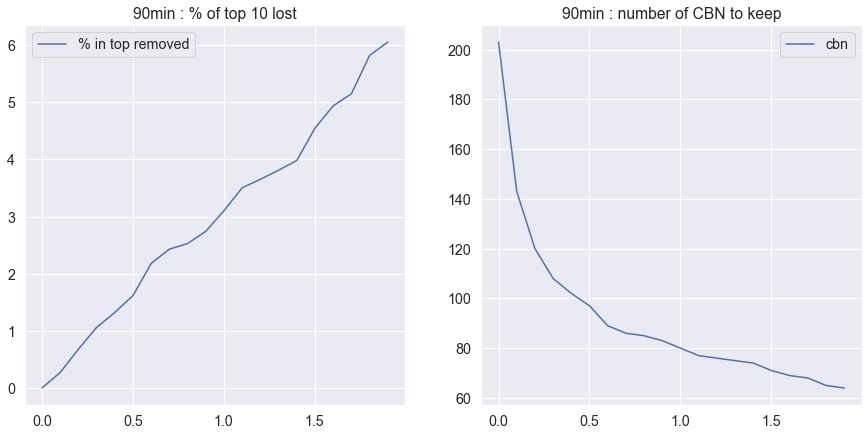

In [24]:
freq = np.linspace(0, 100, 1000)
pourc_top = []
cbn_intop = []

for f in freq:
    pourc_top.append(top10_90min_appear[top10_90min_freq <= f].sum() /top10_90min_appear.sum() * 100)
    cbn_intop.append(len(top10_90min_freq) - len(top10_90min_freq[(top10_90min_freq <= f)]))

f, axes = plt.subplots(1, 2, figsize=(15, 7))

axes[0].set_title("90min : % of top 10 lost")
axes[1].set_title("90min : number of CBN to keep")
sns.lineplot(freq[0:20], pourc_top[0:20], label='% in top removed', ax=axes[0])
sns.lineplot(freq[0:20], cbn_intop[0:20], label='cbn', ax=axes[1])

In [475]:
freq = 1.0
print("We keep ",len(top10_90min_freq) - len(top10_90min_freq[(top10_90min_freq <= freq)]), " CBN.")
print(top10_90min_appear[top10_90min_freq <= freq].sum() /top10_90min_appear.sum() * 100, "% top top 10 lost.")

We keep  80  CBN.
3.1055323105532313 % top top 10 lost.


These 123 CBN we remove contributes to 3.11% of the top 10.

I know create a new data with CBN that appear in top 10 with a frequency > 1.0%.

In [26]:
# Dataframe with only 80CBN
col_save = ['date']
col_save.extend(top10_90min_freq[(top10_90min_freq > 1)].index)
col_save.extend(df_5min.columns[258:])


df_2min[col_save].to_csv(os.path.join(path, "data/data_processed_2min_80"), index=False)
df_5min[col_save].to_csv(os.path.join(path, "data/data_processed_5min_80"), index=False)

# PLOT 90 min, 15min and 5min

In [538]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,6)

cols = df_90min.iloc[:, 1:258].columns

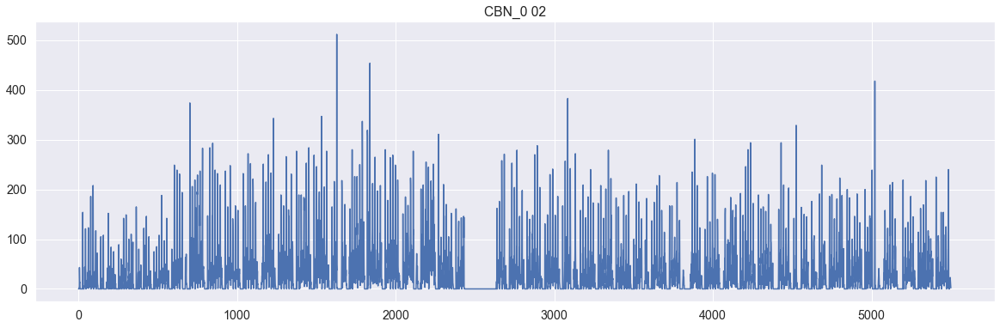

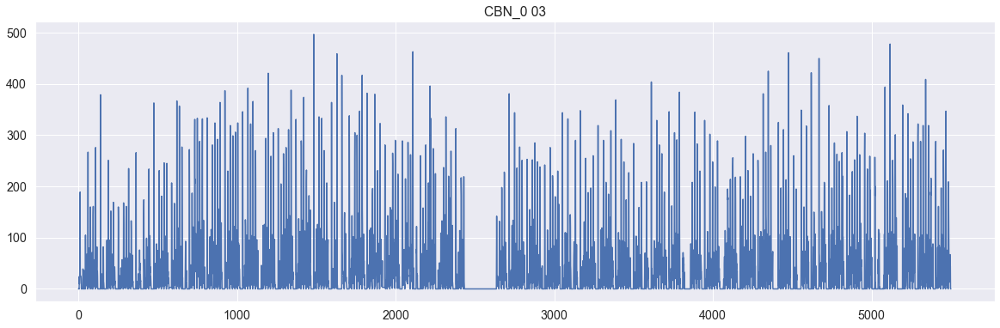

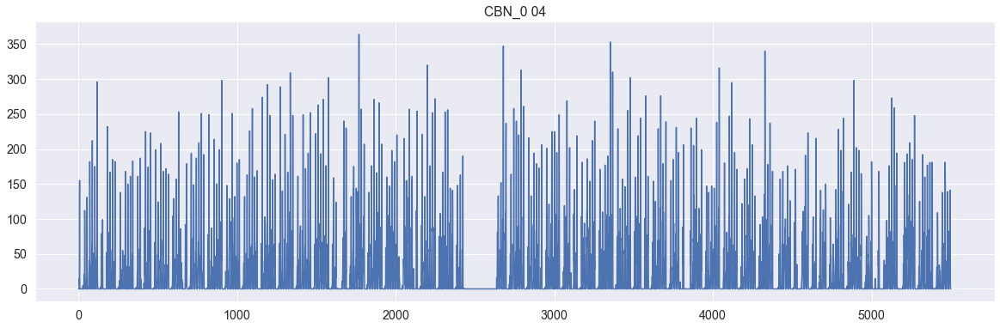

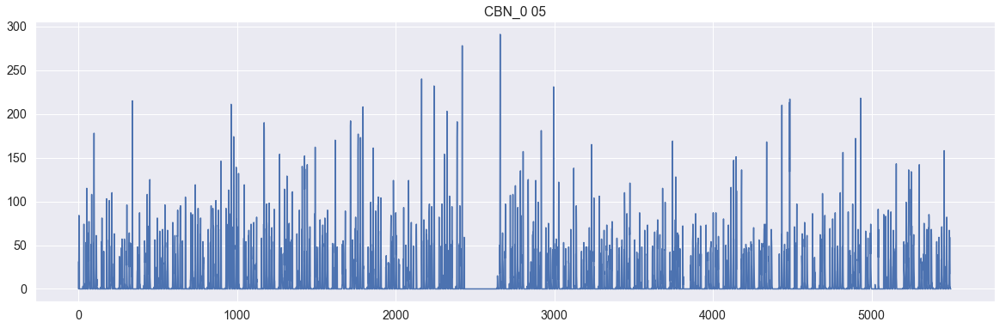

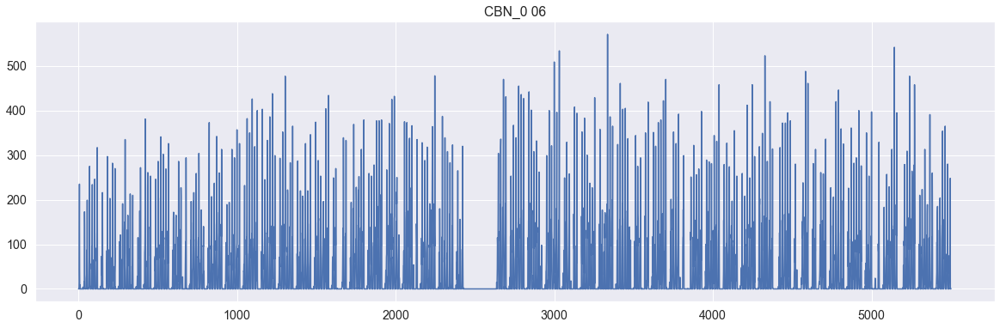

...

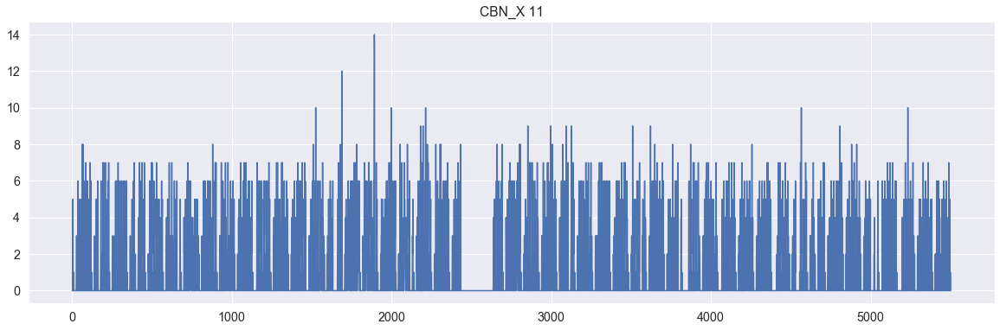

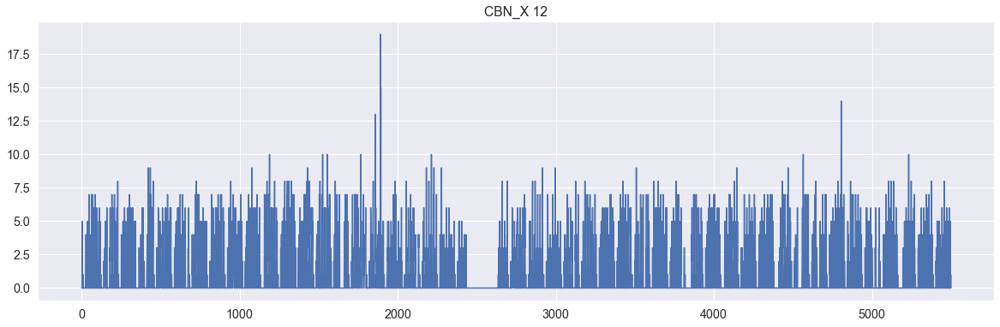

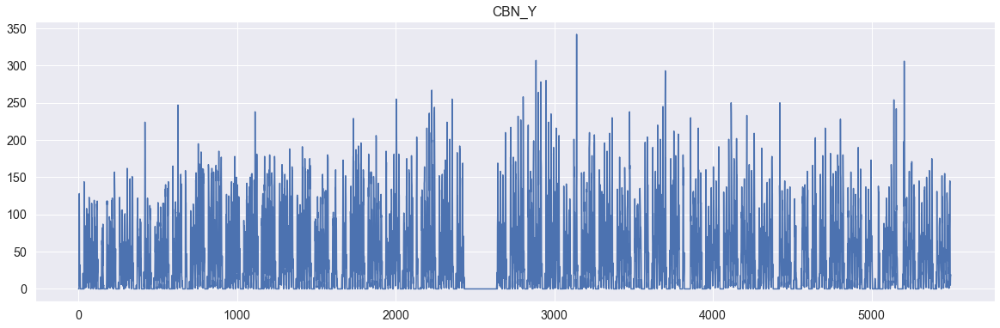

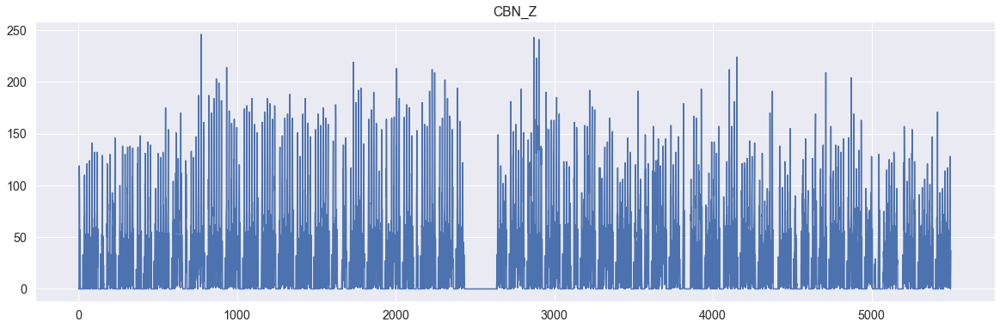

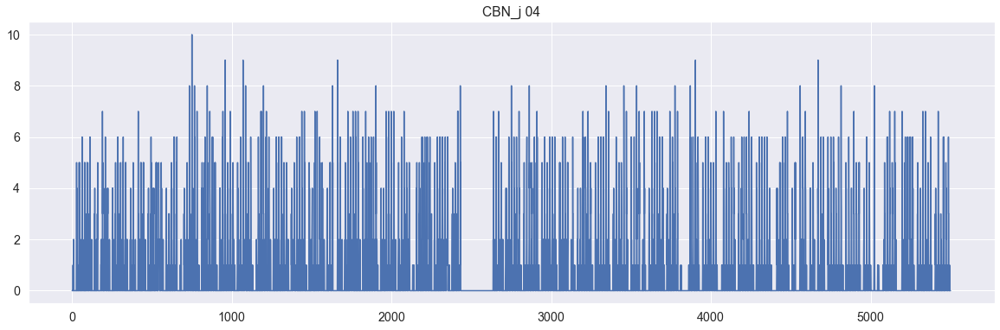

In [542]:
for col in cols:
    plt.title(col)
    plt.plot(df_90min.loc[:,col])
    plt.show()

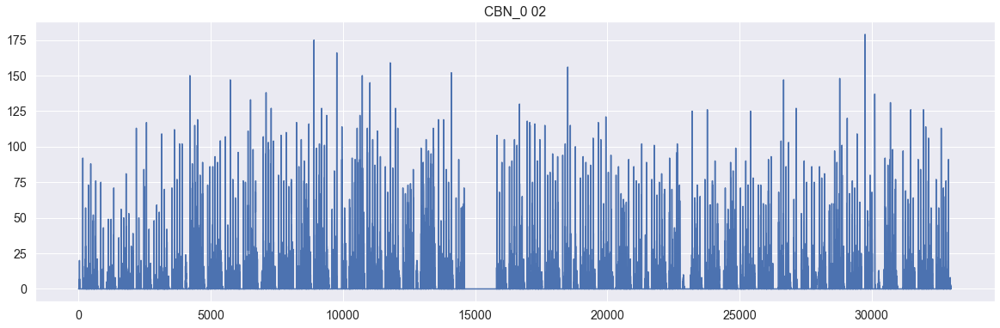

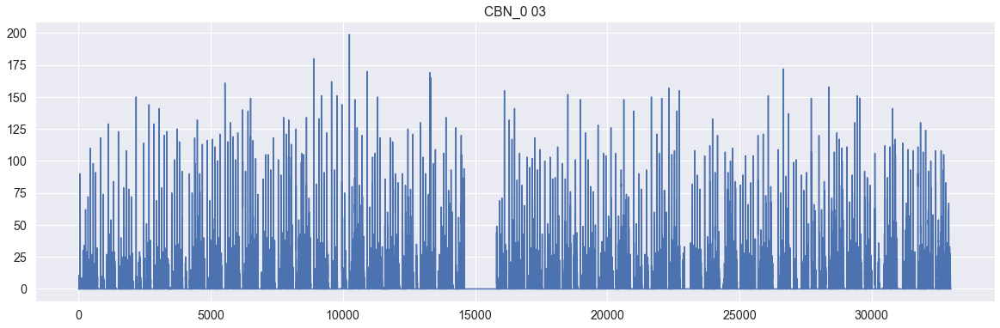

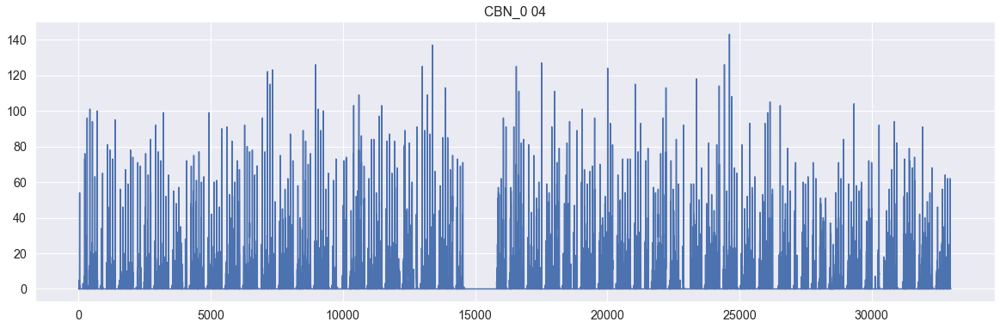

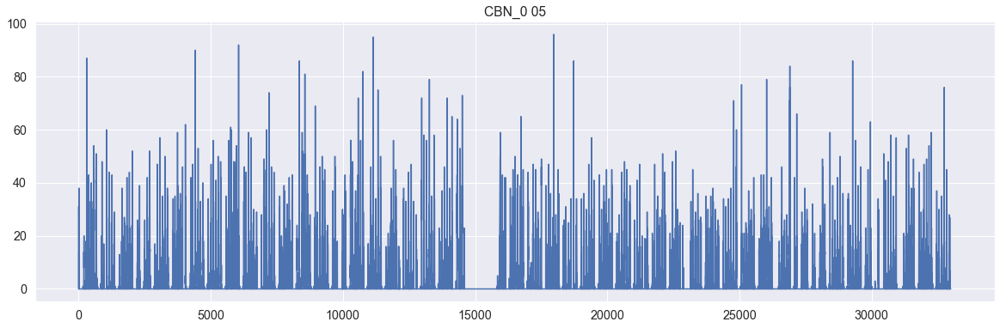

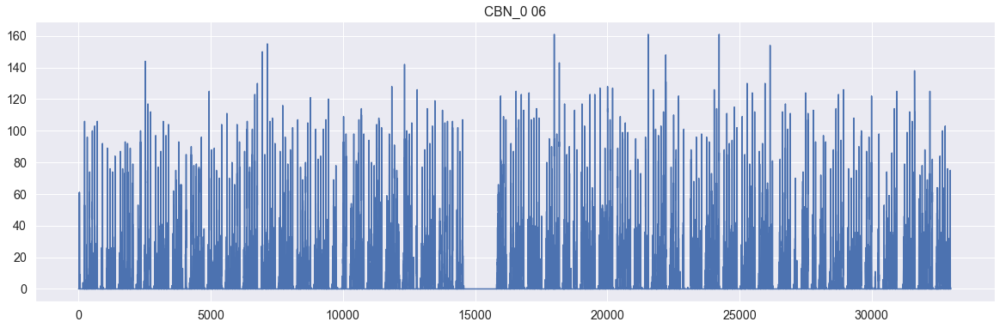

...

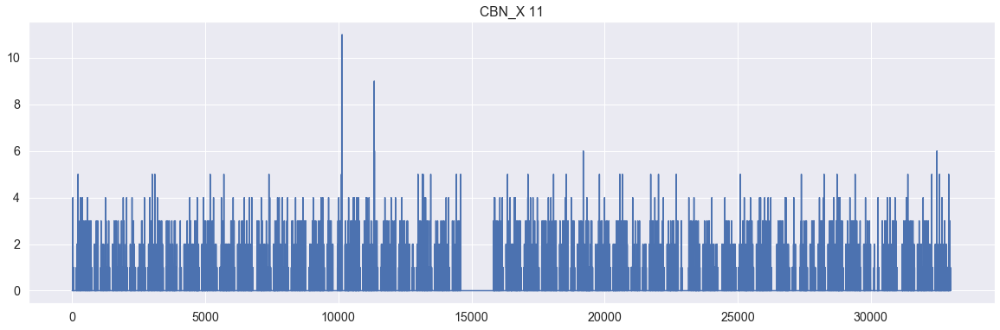

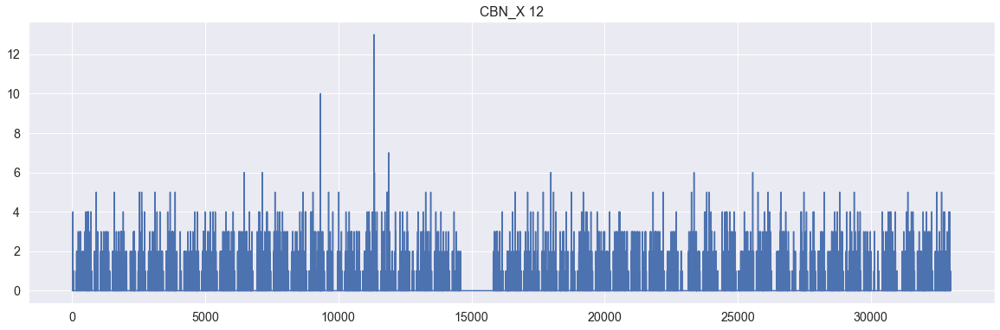

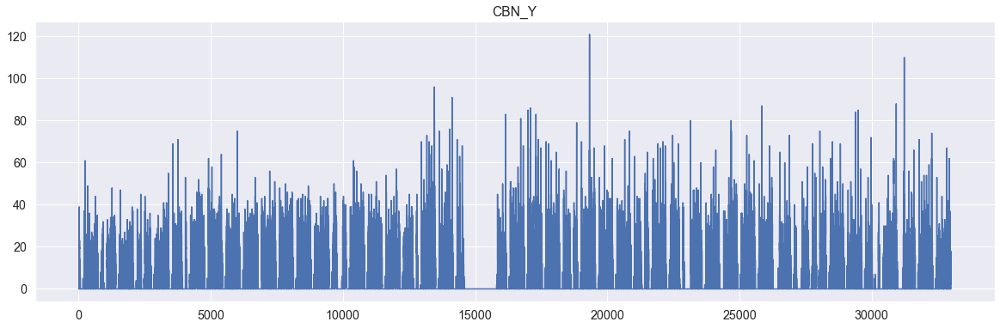

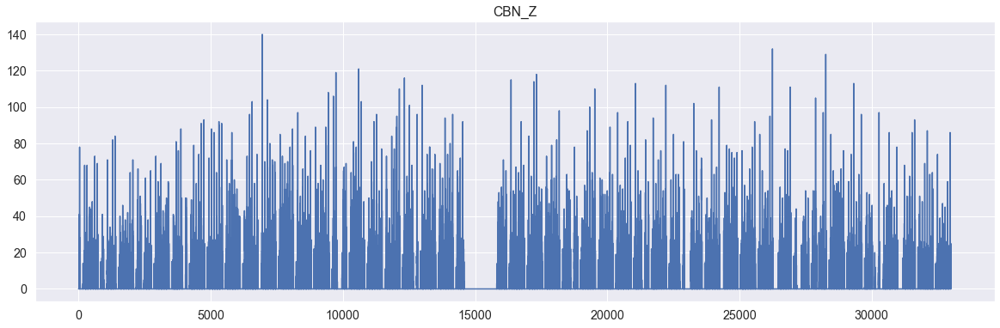

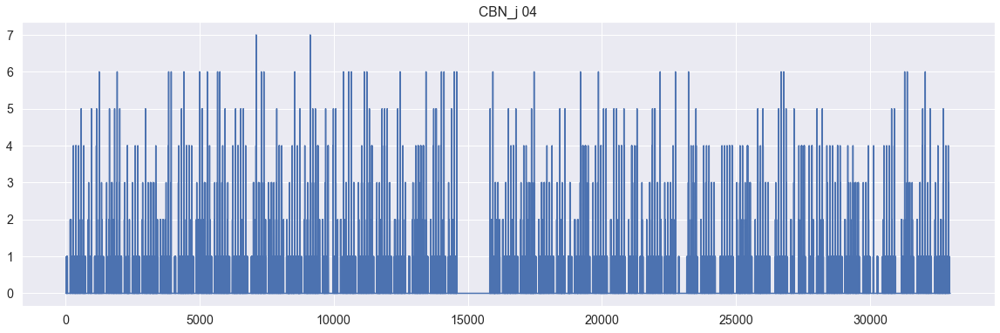

In [543]:
for col in cols:
    plt.title(col)
    plt.plot(df_15min.loc[:,col])
    plt.show()

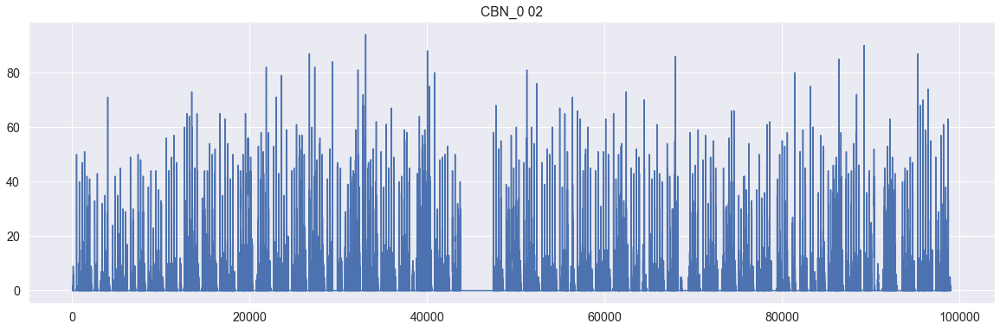

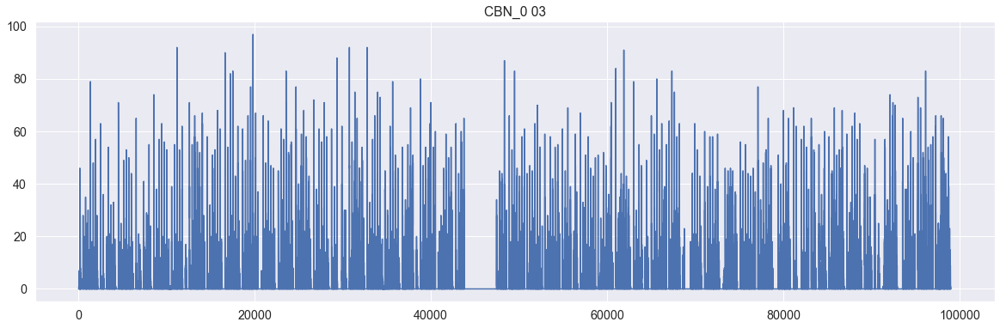

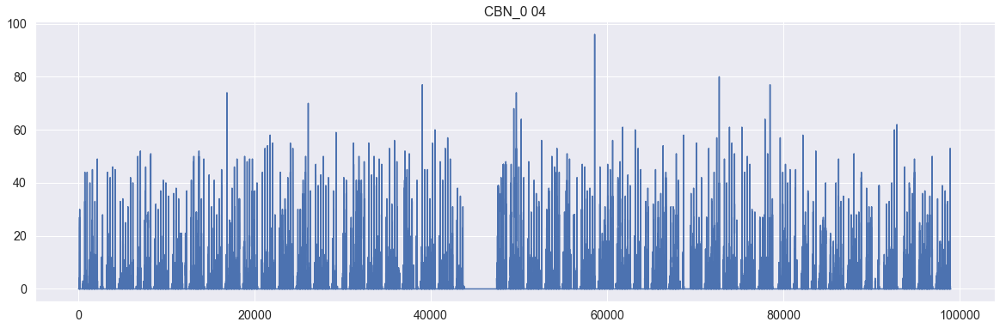

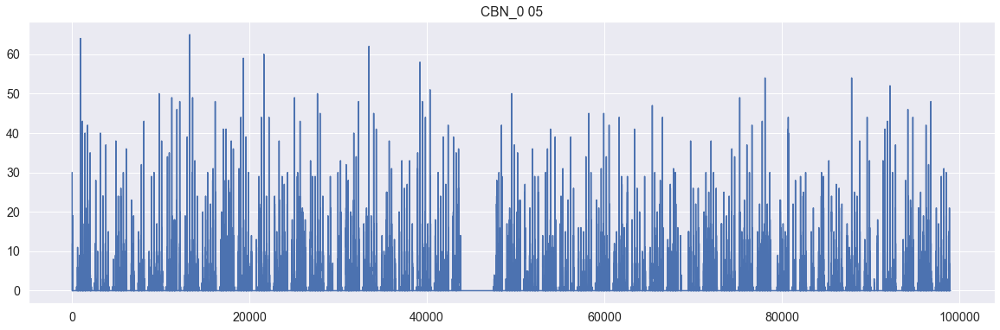

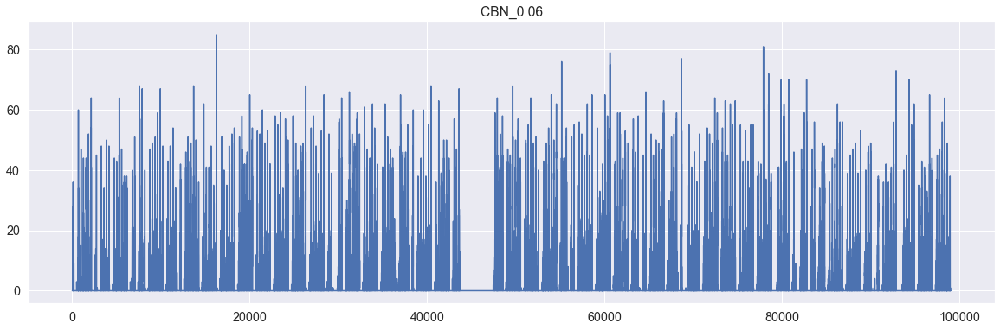

...

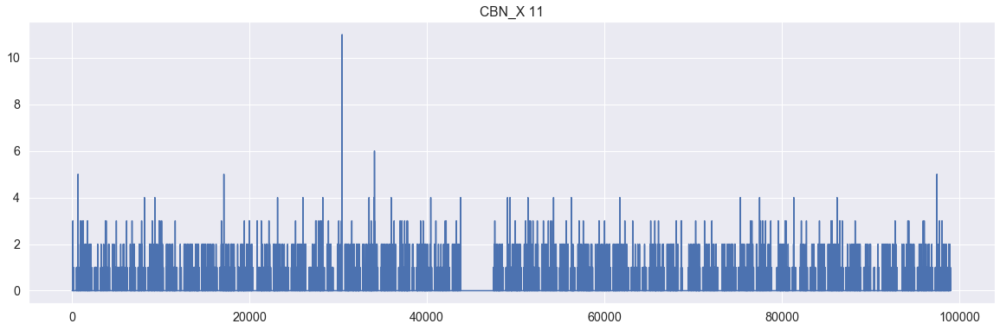

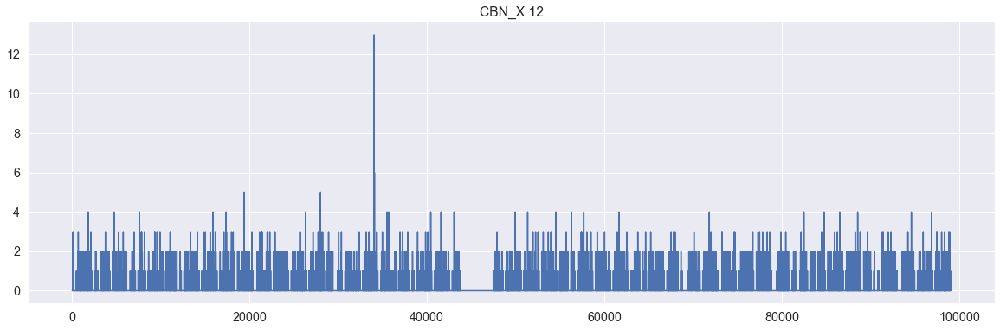

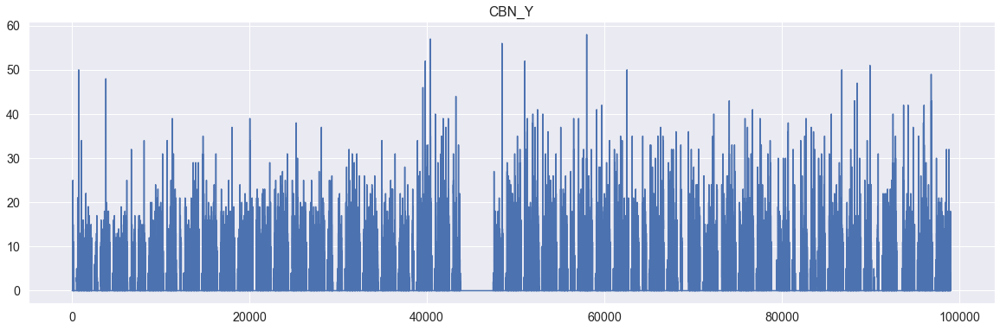

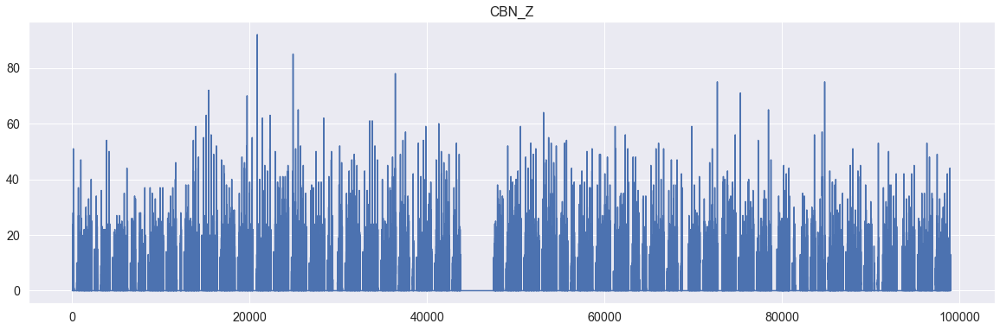

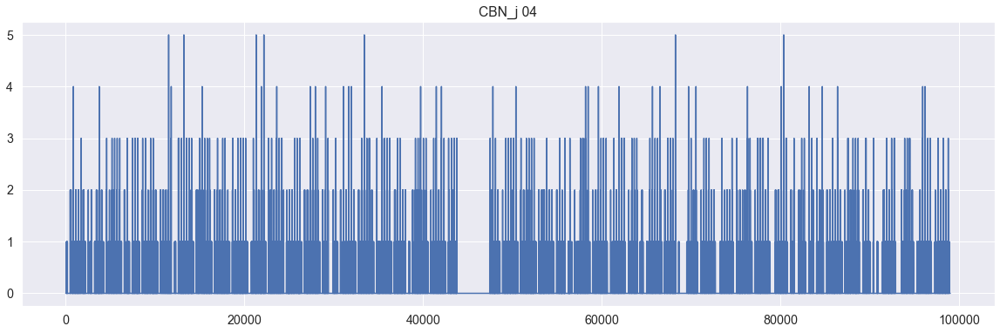

In [547]:
for col in cols:
    plt.title(col)
    plt.plot(df_5min.loc[:,col])
    plt.show()

## STD

Text(0.5, 1.0, 'STD')

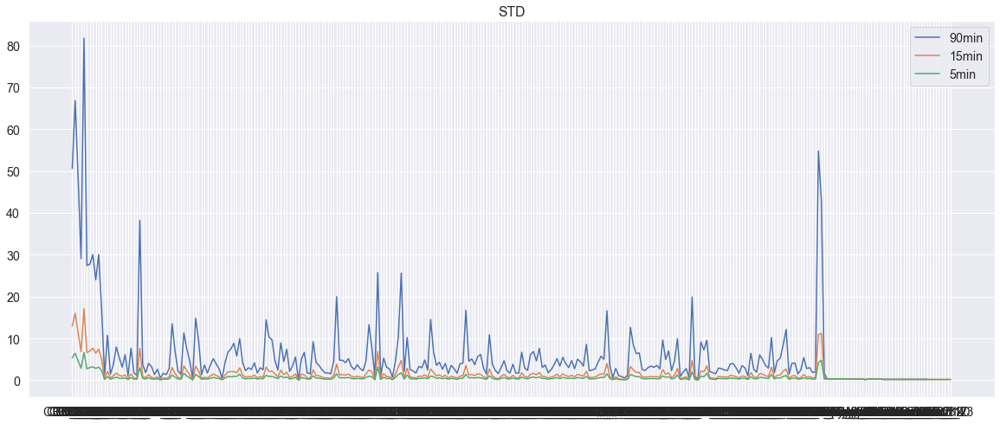

In [546]:
plt.figure(figsize = (20, 8))
plt.plot(df_90min.std(), label='90min')
plt.plot(df_15min.std(), label='15min')
plt.plot(df_5min.std(), label='5min')
plt.legend()
plt.title('STD')